# Estimating from Cov Maps: Radial Method

This notebook first debugged then test the radial estimator.

Notebook includes:

- 0. Radial Estimator
- 0.0. Mark’s Algorithm
- 1. Estimator testing: estimator pipeline
- 2. Estimator Testing: Simulations
- 2.1 Simuation Testing: Estimator outputs 
- 2.2 Simuation Testing: 2D probability histogram level
- 3. Estimator Testing: One Night of data - wind map, detections, clusters, all files, various clusters
- 4. Estimator Testing: All files
- Appendix: Old testing Code


In [1]:
# imports
import numpy as np
import pandas as pd
import numpy.ma as ma
import importlib
import matplotlib
from astropy.stats import sigma_clipped_stats
from importlib import reload
import time

# ignore warnings
import warnings
warnings.filterwarnings("ignore")

#personal
from pipeline.est_pipeline import *
from pipeline.code.Correlator import *
from pipeline.code.file_reader import *
from pipeline.code.corr_plots import *
from pipeline.code.cluster import *

import pipeline.code.Estimator as es
import pipeline.code.Estimator_R as er
import pipeline.code.data_table as d_t
import pipeline.code.graph_code as gc

# 0. Radial Estimator
Jupyter Notebook version of code now in Estimator_R.py. Do not need to use if importing the python file. 

## 0.0 Mark's Algorithm

**Part 1.**  in each time slice
- 1.1.  For each pixel in the cov map assign a radius
- 1.2. find the mean (m) and stddev (sd) of the pixels in a radial annuli one pixel wide (r from 1 to 7 +/- 0.5.  I do a sigma clipping on this with a clip=2 sigma
- 1.3. For each pixel I assign a "detection level in sigma over the mean" = 
(im[x,y]m)/sd.   This results in a detection map for each cov map time slice. 

**Part 2.**  Detection Map
- For each detection greater than some value I calculate a speed (vspd), direction (vdir).  
- This results in a speed and a direction "detection" map for each time slice.

**Part 3.**  Projection
- In addition to the vspd and vdir maps, I also calculate the x,y location at the edge of the "circle" where the vdir projects to.   
- Namely, xedgei = r0 * cos(thetai)
- This makes the clustering analysis easier as it does away with the 2pi wrapping

**Part 4.**  Custer
- I then "cluster" all the on vspd, vedgex, and vedgey derived from all time slices together for detections greater than some threshold.  
- Note that by keeping the detection level, its super easy to redo this analysis for another threshold...
- Output contains the cluster layers -> mean and std dev of speed and direction (derived from mean edgex, edgey).

**Part 5.**  Layer Labeling
- I do this for xcov (all xcov averaged together - not correct thing to do but I did for SNR issues) 
- and for the acov and then compare if it found a layer in the xcov that is "similar" to a layer in the acov.  
- If so I mark it as a GL.  If not I mark it as a FA layer...

In [5]:
# creating the corr map average

## this code is pretty similar to Estimator.py pull_data() function

def acor_map(data):
    x_acor, y_acor = data.data_get_ac(avg_sub=False, avg_len=0)
    avg_wfs = np.average((x_acor + y_acor)/2, axis=0)
    return avg_wfs

def xcor_map(data):
    x_ccor, y_ccor = data.data_get_cc_all(avg_sub=False, avg_len=0)
    avg_ccor = (x_ccor + y_ccor)/2

    wfs_use = data.active_wfs

    ccors_only = np.zeros_like(avg_ccor[0][0])
    count = 0
    for i, row in enumerate(avg_ccor):
        for j in range(len(row)):
            if i < j and wfs_use[i] and wfs_use[j]:
                ccors_only = ccors_only + row[j]
                count = count + 1
    avg_wfs = np.divide(ccors_only, count)
    return avg_wfs

In [6]:
#Cov map radii

rad_map = np.array([[np.sqrt(i**2 + j**2) for j in np.arange(-7, 8)] for i in np.arange(-7, 8)])

rad_map_boolean = np.zeros((8, 15, 15))
# boolean mask matrix
for i in np.arange(0, 8):
    rad_max = ma.masked_where(rad_map <=  i + 0.5, rad_map)
    rad_min = ma.masked_where(rad_map >  i - 0.5, rad_map)
    rad = rad_max.mask & rad_min.mask
    rad_map_boolean[i-1] = rad

rad_map_inv = np.ones(rad_map_boolean.shape) - rad_map_boolean

In [7]:
# 1.  in each time slice

def detect_map(avg_wf):
    #detect_lvl = np.zeros_like(avg_wfs)
    t_mean = np.zeros_like(avg_wf)
    t_stdev = np.zeros_like(avg_wf)

    for t in range(avg_wf.shape[0]):
        # 1.1.  For each pixel in the cov map assign a radius
        t_slice = avg_wf[t]
        sigma = 3
        # 1.2. find the mean (m) and stddev (sd) of the pixels 
        # in a radial annuli one pixel wide (r from 1 to 7 +/- 0.5.  
        # I do a sigma clipping on this with a clip=3 si
        for r in np.arange(8):
            rad_vals = np.multiply(t_slice, rad_map_boolean[r])
            mean, median, std = sigma_clipped_stats(rad_vals, sigma=sigma, mask=rad_map_inv[r])
            # TRY REDOING MASKING => try to flatten?
            #print(t, r, mean, std)
            t_mean[t] = t_mean[t] + mean*rad_map_boolean[r]
            t_stdev[t] = t_stdev[t] + std*rad_map_boolean[r]
    # 1.3. For each pixel I assign a "detection level in sigma over the mean" = (im[x,y] - m)/sd.   This results in a detection map for each cov map time slice. 
    detect_map = np.divide(np.subtract(avg_wf, t_mean), t_stdev)
    #print(avg_wfs.shape, t_stdev.shape)
    return detect_map
        

In [8]:
#### 2
# For each detection greater than some value I calculate a speed (vspd), direction (vdir). 
# This results in a speed and a direction "detection" map for each time slice.

def dist_c(x, y, c):
    #BUG: hard-coded 2.2 meter telescope
    pix_to_m = 2.2/15.0
    return np.sqrt(np.square(x-c) + np.square(y-c))

def dir_c(x,y,c):
    return np.arctan2(x-c, c-y)
    
### 3
# I also calculate the x,y location at the edge of the "circle" where the vdir projects to.
# Namely, xedgei = r0 * cos(thetai) 
# This makes the clustering analysis easier as it does away with the 2pi wrapping
    
def proj_x(dir_rad, c):
    return c*np.sin(dir_rad)

def proj_y(dir_rad, c):
    return c*np.cos(dir_rad)

In [9]:
def speed_map(detection_map, detect_val, hz):
    radius = 7
    
    #maps of the distance and direction for each pixel
    dist_map = np.array([[dist_c(x,y, radius) for y in range(15)] for x in range(15)])
    dir_map = np.array([[dir_c(x,y, radius) for y in range(15)] for x in range(15)])
    
    #plt.matshow(dir_map)
    
    #storing arrays
    speed_list = np.array([])
    dir_list = np.array([])
    x_proj = np.array([])
    y_proj = np.array([])
    
    #values above detection value => make a map for detections
    i = 1
    for t_slice in detection_map:
        t_slice = ma.masked_invalid(t_slice)
        detect_t = ma.masked_where(t_slice <= detect_val, t_slice)
        #BUG: positive detections only
        
        t = i/hz
        speed_t = np.divide(dist_map, t*(8/2.2))
        
        # Before adding to list, determine which were 
        speed_det = speed_t[detect_t.mask == False]
        speed_list = np.append(speed_list, speed_det)
          
        dir_det = dir_map[detect_t.mask == False]
        dir_list = np.append(dir_list, dir_det)
        
        x_t = proj_x(dir_det, radius)
        y_t = proj_y(dir_det, radius)
        
        x_proj = np.append(x_proj, x_t)
        y_proj = np.append(y_proj, y_t)
        
        i+=1
        #if i>100: break
        
    return [speed_list, dir_list, x_proj, y_proj]

In [10]:
### 4
# "cluster" all the on vspd, vedgex, and vedgey derived from all time slices together for detections greater than some threshold. 

from numpy import unique
from numpy import where
from sklearn.datasets import make_classification
from sklearn.cluster import MeanShift
from sklearn.cluster import DBSCAN
from sklearn.cluster import AffinityPropagation
from matplotlib import pyplot


def detect_cluster(vspd, vedgex, vedgey):
    return None

def detect_cluster_meanshift(data, vspd, vedgex, vedgey):
    X = np.array([[vspd[i],vedgex[i],vedgey[i]] for i in range(spds.shape[0])])

    # define the model
    model = MeanShift()
    # fit model and predict clusters
    yhat = model.fit_predict(X)
    # retrieve unique clusters
    clusters = unique(yhat)
    # create scatter plot for samples from each cluster
    print("============ Mean shift ==========")
    for cluster in clusters:
        # get row indexes for samples with this cluster
        row_ix = where(yhat == cluster)
        # create scatter of these samples
        print("Dir:    ", np.median(dirs[row_ix]))
        print("  sdv:  ", np.std(dirs[row_ix]))
        print("Spd:    ", np.median(spds[row_ix]))
        print("  sdv:  ", np.std(spds[row_ix]))
        print("======================")
        pyplot.scatter(dirs[row_ix], spds[row_ix])
    # show the plot
    pyplot.title("meanshift \n" + data.name) 
    pyplot.show()
    
    
def detect_cluster_dbscan(data, vspd, vedgex, vedgey):
    X = np.array([[vspd[i],vedgex[i],vedgey[i]] for i in range(spds.shape[0])])

    # define the model
    model = DBSCAN(eps=0.30, min_samples=5)
    # fit model and predict clusters
    yhat = model.fit_predict(X)
    # retrieve unique clusters
    clusters = unique(yhat)
    # create scatter plot for samples from each cluster
    print("============ DBSCAN ==========")

    for cluster in clusters:
        # get row indexes for samples with this cluster
        row_ix = where(yhat == cluster)
        # create scatter of these samples
        print("Dir:    ", np.median(dirs[row_ix]))
        print("  sdv:  ", np.std(dirs[row_ix]))
        print("Spd:    ", np.median(spds[row_ix]))
        print("  sdv:  ", np.std(spds[row_ix]))
        print("======================")
        pyplot.scatter(dirs[row_ix], spds[row_ix])
    # show the plot
    pyplot.title("DBSCAN \n" + data.name)
    pyplot.show()
    
    
def detect_cluster_affprop(data, vspd, vedgex, vedgey):
    X = np.array([[vspd[i],vedgex[i],vedgey[i]] for i in range(spds.shape[0])])

    # define the model
    model = AffinityPropagation(damping=0.9)
    # fit the model
    model.fit(X)
    # assign a cluster to each example
    yhat = model.predict(X)
    # retrieve unique clusters
    clusters = unique(yhat)
    # create scatter plot for samples from each cluster
    print("============ Affinity Prop ==========")
    for cluster in clusters:
        # get row indexes for samples with this cluster
        row_ix = where(yhat == cluster)
        # create scatter of these samples
        print("Dir:    ", np.median(dirs[row_ix]))
        print("  sdv:  ", np.std(dirs[row_ix]))
        print("Spd:    ", np.median(spds[row_ix]))
        print("  sdv:  ", np.std(spds[row_ix]))
        print("======================")
        pyplot.scatter(dirs[row_ix], spds[row_ix])
    # show the plot
    pyplot.title("AffinityPropagation \n" + data.name)
    pyplot.show()
    

## 1. Estimator Testing: estimator pipeline 

Not sure what fits in this is, but this is a simple test of the estimator on files

In [3]:
reload(er)

<module 'pipeline.code.Estimator_R' from '/home/emcewen/code_dev/pipeline/code/Estimator_R.py'>

20201222_aocb_2020121_221213o
20201222_aocb_2020122_012857o
20201222_aocb_2020122_043832o
20201222_aocb_2020122_074836o
20201222_aocb_2020122_101126o
20201222_aocb_2020122_121720o
20201222_aocb_2020122_142344o


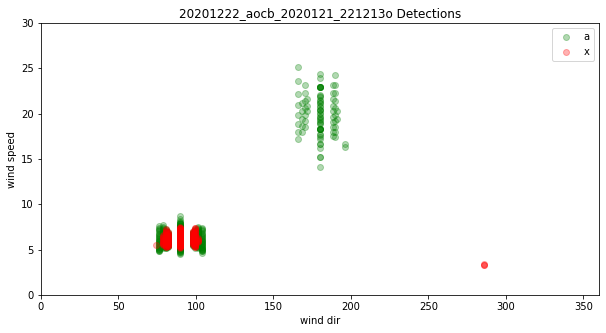

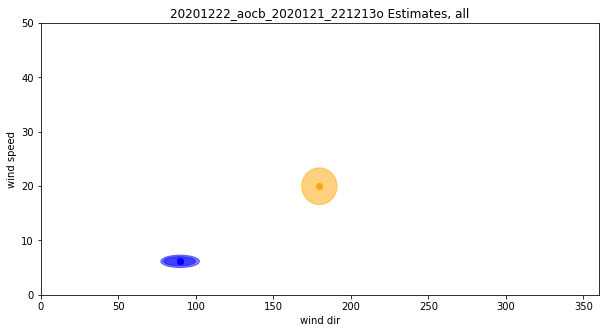

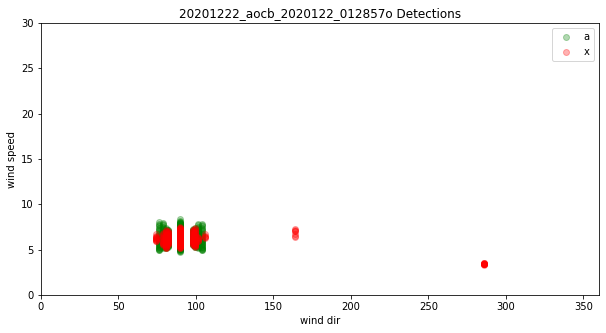

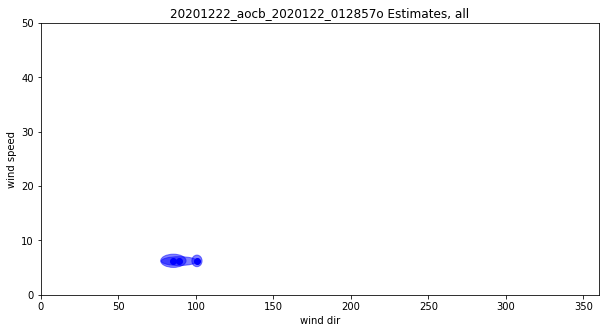

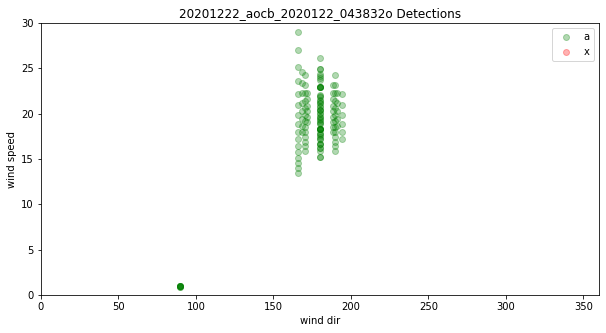

...

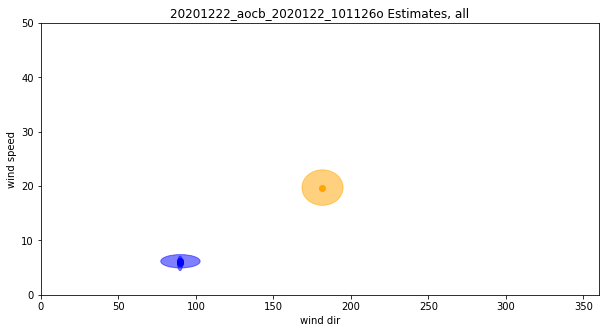

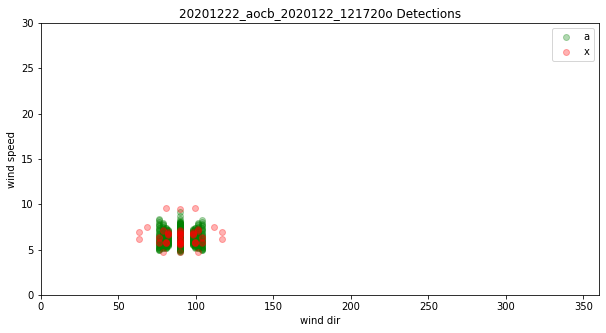

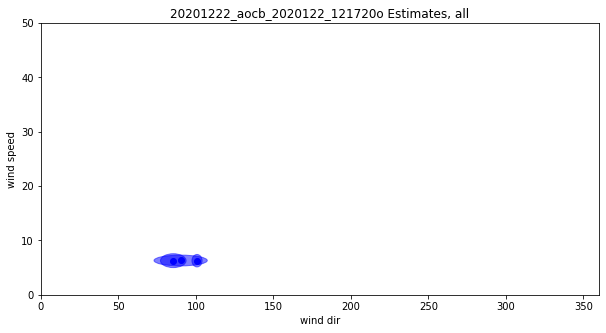

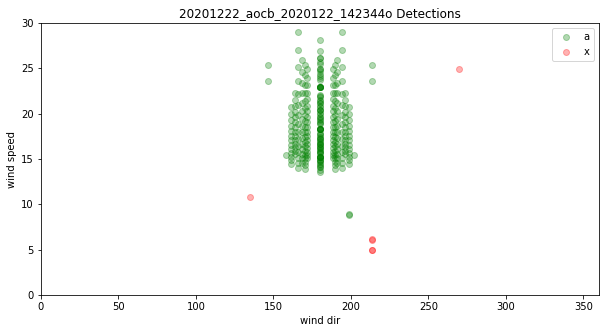

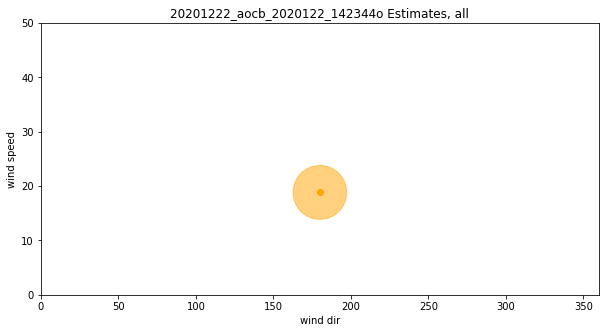

In [37]:
for i in fits_in:
    er.est_file(i, plot = True)

In [22]:
strngs = '/home/emcewen/out_sim/20201222/plots/txt/20201222_aocb_2020121_221213o_sttest_simple_0..txt'
strngs.replace("plots/", "est/")

'/home/emcewen/out_sim/20201222/est/txt/20201222_aocb_2020121_221213o_sttest_simple_0..txt'

# 2. Estimator Testing: Simulations

In this section we use a list of fits files connected to simulations with known layers to see the performance of our estimator

## 2.1 Estimator outputs on simulations

In [4]:
reload(er)

<module 'pipeline.code.Estimator_R' from '/home/emcewen/code_dev/pipeline/code/Estimator_R.py'>

In [5]:
# newest list of all simulations
f_dir = "/home/emcewen/out_sim/20201222/fits/"
fts = ["20201222_aocb_2020121_221213o_tmax200_stt.fits",
       "20201222_aocb_2020122_012857o_tmax200_stt.fits",
       "20201222_aocb_2020122_043832o_tmax200_stt.fits",
       "20201222_aocb_2020122_074836o_tmax200_stt.fits",
       "20201222_aocb_2020122_101126o_tmax200_stt.fits",
       "20201222_aocb_2020122_121720o_tmax200_stt.fits",
       "20201222_aocb_2020122_142344o_tmax200_stt.fits"]
#input fits
s_fits_in = [f_dir + ft for ft in fts]

In [44]:
# Creating a df for the all in fits_in
s_df_total = pd.DataFrame()
for fts in s_fits_in:
    er_pipe = er.Estimate_simple(fts, n_filter = 10)
    table = er_pipe.return_table()
    s_df_total = pd.concat([s_df_total, table])


In [33]:
#df_total

In [41]:
#er.plot_clstr_table(df_total, name="Simulation 20201222").show()

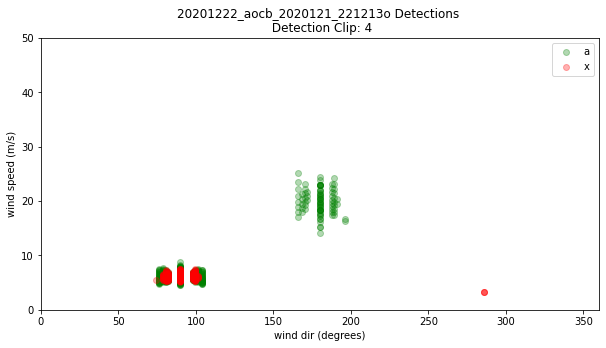

In [27]:
er_pipe = er.Estimate_simple(s_fits_in[0], detect_clp = 5)
table = er_pipe.return_table(detect_clp = 4)
er_pipe.plot_spds_detect().show()

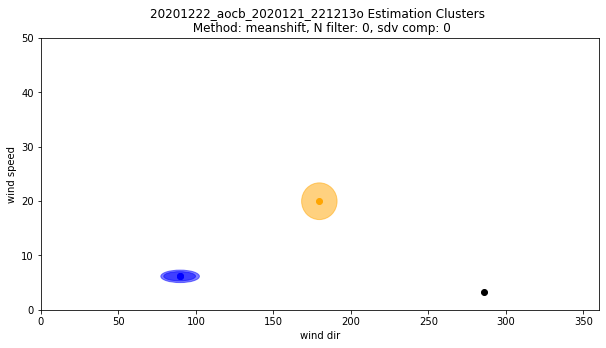

In [28]:
er_pipe.plot_clstr().show()

## 2.2 Simulation Testing: 2D probability histogram devel

In [ ]:
s_fits_in[0]

In [ ]:
reload(er)
# testing the 2D histogram
er_pipe = er.Estimate_simple(s_fits_in[0])
# transtlating these to velocities in the x and y
# we generate a direction map
er_pipe.run()
er_pipe.run(xcor = True)

print(er_pipe.name)

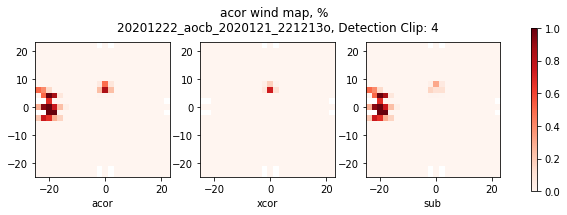

In [61]:
er_pipe.plot_prob_hist().show()

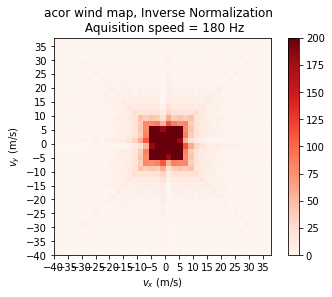

In [8]:
# histogram variables that will be used for all three plots
rmin = -40
rmax = 40
rinc = 2
rlab = 5

# Creating a normalization matrix
# size of simulations: (201, 15, 15)
full_detect = np.ones([201, 15, 15])
detect_val = 0.5
hz = 180

# Creating a detect map of 100% detections
speeds_full = er.speed_map(full_detect, detect_val, hz)
detect_list, speed_list, dir_list, x_proj, y_proj = speeds_full

v_x = er.proj_x(dir_list, speed_list)
v_y = er.proj_y(dir_list, speed_list)
# Historgram plot of xs and ys

n_H, xedges, yedges = np.histogram2d(v_x, v_y, bins=[np.arange(rmin, rmax, rinc), np.arange(rmin, rmax, rinc)])
n_m = plt.imshow(n_H, interpolation='nearest', origin='low',
                extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]], vmax = 200, cmap=plt.cm.Reds)

plt.title('acor wind map, Inverse Normalization  \n Aquisition speed = ' + str(hz) + ' Hz')
plt.xlabel('$v_x$ (m/s)')
plt.ylabel('$v_y$ (m/s)') 
plt.colorbar(n_m)
plt.xticks(np.arange(rmin, rmax, rlab))
plt.yticks(np.arange(rmin, rmax, rlab))
plt.show()

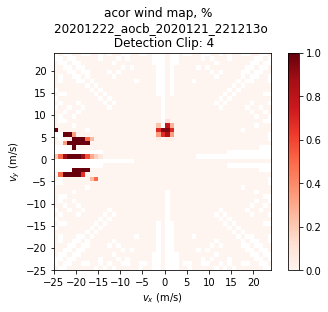

In [18]:
aspds, adirs = er_pipe.a_spds, er_pipe.a_dirs
# we get speeds and directions out of  run
av_x = er.proj_x(adirs, aspds)
av_y = er.proj_y(adirs, aspds)

norma = av_x.shape[0]

aH, xedges, yedges = np.histogram2d(av_x, av_y, bins=[np.arange(rmin, rmax, rinc), np.arange(rmin, rmax, rinc)])
m = plt.imshow(aH / n_H, interpolation='nearest', origin='low',
                extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]], cmap=plt.cm.Reds)

param_title = "Detection Clip: "+ str(er_pipe.detect_clp) 
plt.title('acor wind map, %  \n' +er_pipe.name +' \n ' + param_title)
plt.xlabel('$v_x$ (m/s)')
plt.ylabel('$v_y$ (m/s)') 
plt.colorbar(m)
plt.xticks(np.arange(rmin, rmax, rlab))
plt.yticks(np.arange(rmin, rmax, rlab))
plt.show()

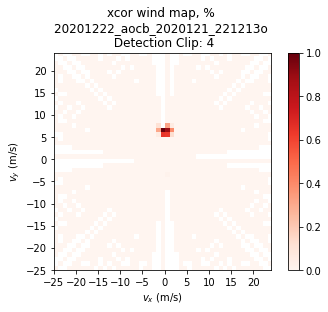

In [19]:
xspds, xdirs = er_pipe.x_spds, er_pipe.x_dirs
# we get speeds and directions out of  run
xv_x = er.proj_x(xdirs, xspds)
xv_y = er.proj_y(xdirs, xspds)

normx = xv_x.shape[0]

xH, xedges, yedges = np.histogram2d(xv_x, xv_y, bins=[np.arange(rmin, rmax, rinc), np.arange(rmin, rmax, rinc)])
m = plt.imshow(xH/n_H, interpolation='nearest', origin='low',
                extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]], cmap=plt.cm.Reds)

param_title = "Detection Clip: "+ str(er_pipe.detect_clp)
plt.title('xcor wind map, % \n' +er_pipe.name +' \n ' + param_title)
plt.xlabel('$v_x$ (m/s)')
plt.ylabel('$v_y$ (m/s)') 

plt.colorbar(m)
plt.xticks(np.arange(rmin, rmax, rlab))
plt.yticks(np.arange(rmin, rmax, rlab))
plt.show()

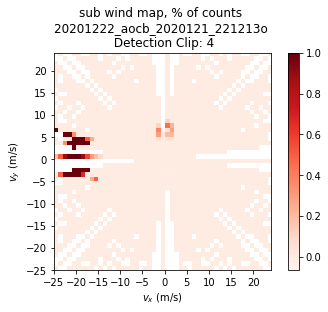

In [20]:
m = plt.imshow(aH/n_H - xH/n_H, interpolation='nearest', origin='low',
                extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]], cmap=plt.cm.Reds)

param_title = "Detection Clip: "+ str(er_pipe.detect_clp)
plt.title('sub wind map, % of counts \n' +er_pipe.name +' \n ' + param_title)
plt.xlabel('$v_x$ (m/s)')
plt.ylabel('$v_y$ (m/s)')

plt.colorbar(m)
plt.xticks(np.arange(rmin, rmax, rlab))
plt.yticks(np.arange(rmin, rmax, rlab))
plt.show()

# 3. Estimator Testing: One Night

Choosing 20180526

In [93]:
reload(er)

<module 'pipeline.code.Estimator_R' from '/home/emcewen/code_dev/pipeline/code/Estimator_R.py'>

In [94]:
# pulling in date
df_main = pd.read_csv("/home/emcewen/code_dev/csv/20180526.csv")
# filtering type of file
rslt_df = df_main[df_main['ttsub'] == True]
rslt_df = rslt_df.drop_duplicates(subset=['dataname']).sort_values(by=['dataname'])
# pulling cov fits files
fits = rslt_df["outfits"]
#input fits
fits_in = fits.values

In [116]:
fits_in.shape

(43,)

In [207]:
er_pipe = er.Estimate_simple(fits_in[42])
er_pipe.detect_clp = 2
table = er_pipe.return_table()

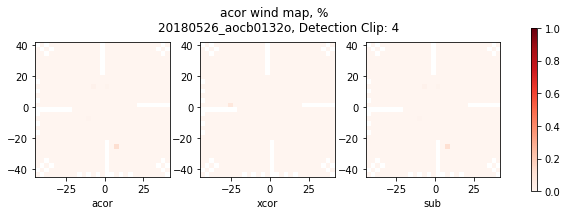

In [206]:
er_pipe.plot_prob_hist(rmin = -45, rmax = 45, rinc = 3).show()

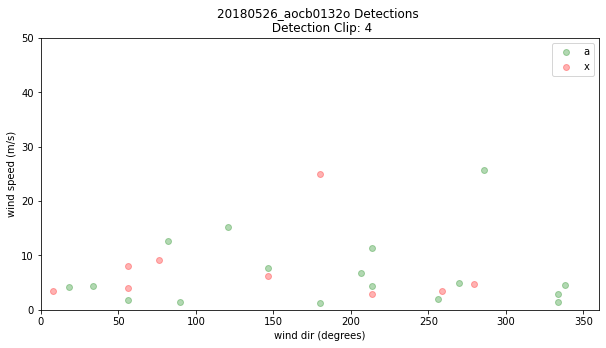

In [204]:
er_pipe.plot_spds_detect().show()

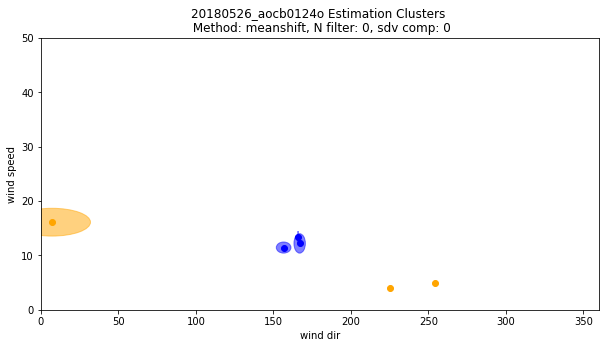

In [83]:
er_pipe.plot_clstr().show()

20180526_aocb0011o


TypeError: save_plot() takes 2 positional arguments but 4 were given

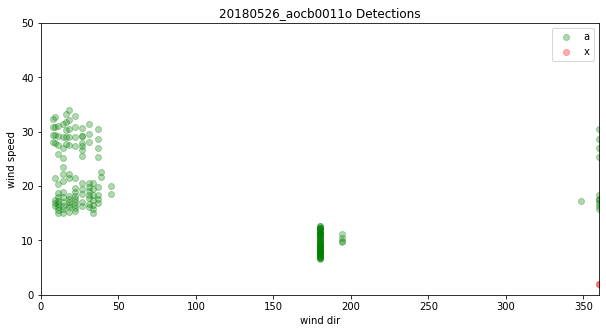

In [37]:
tic = time.perf_counter()
for i in fits_in:
    er.est_file(i, plot = True)
toc = time.perf_counter()
print(f"Estimates in {toc - tic:0.4f} seconds")

In [42]:
df_0526_ms = pd.DataFrame()
method = er.detect_cluster_meanshift

for fts in fits_in:
    print(fts)
    er_pipe = er.Estimate_simple(fts)
    table = er_pipe.return_table(clstr_method = method, sdv_cnd = 2, n_filter = 20)
    df_0526_ms = pd.concat([df_0526_ms, table])
df_0526_ms["method"] = "meanshift"

/home/emcewen/out/20180526/fits/20180526_aocb0011o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0124o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0070o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0111o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0119o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0039o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0108o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0031o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0132o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0126o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0072o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0005o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0120o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0128o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb010

In [38]:
df_0526_ms

,dir,dir_std,spd,spd_std,count,class,xcor,name,method
0,20.764455,11.971616,18.000328,1.945455,71.0,FL,0,20180526_aocb0011o,meanshift
1,180.943945,3.528663,9.534776,1.737353,59.0,FL,0,20180526_aocb0011o,meanshift
2,17.769686,9.850192,29.104553,2.326140,49.0,FL,0,20180526_aocb0011o,meanshift
0,7.248621,16.530633,16.116931,1.705532,122.0,FL,0,20180526_aocb0124o,meanshift
1,166.991671,2.456105,12.212054,1.193122,19.0,NA,1,20180526_aocb0124o,meanshift
2,156.644978,3.156386,11.450784,0.681973,11.0,NA,1,20180526_aocb0124o,meanshift
0,167.573017,6.792993,9.784843,3.026034,28.0,GL,0,20180526_aocb0111o,meanshift
1,169.200937,7.081532,9.679268,2.569414,22.0,GL,1,20180526_aocb0111o,meanshift


In [43]:
#df_0526_ms[df_0526_ms["class"]=="FL"]

<bound method Figure.show of <Figure size 720x360 with 1 Axes>>

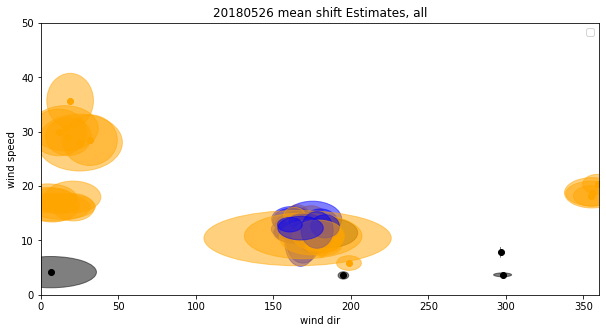

In [44]:
date_name = "20180526 mean shift"
er.plot_clstr_table(df_0526_ms[ df_0526_ms["dir_std"] < 50 ], min_count=0, name=date_name).show

In [81]:
#Cluster methods
    # detect_cluster_meanshift
    # detect_cluster_dbscan
    # detect_cluster_affprop

df_0526_dbs = pd.DataFrame()
method = clstr_method = er.detect_cluster_dbscan

for fts in fits_in:
    print(fts)
    er_pipe = er.Estimate_simple(fts)
    er_pipe.run(clstr_method = method)
    er_pipe.run(clstr_method = method, xcor = True)
    table = er_pipe.return_table()
    df_0526_dbs = pd.concat([df_0526_dbs, table])
df_0526_dbs["method"] = "dbscan"

/home/emcewen/out/20180526/fits/20180526_aocb0011o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0124o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0070o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0111o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0119o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0039o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0108o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0031o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0132o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0126o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0072o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0005o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0120o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb0128o_tmax200_stt.fits
/home/emcewen/out/20180526/fits/20180526_aocb010

<bound method Figure.show of <Figure size 720x360 with 1 Axes>>

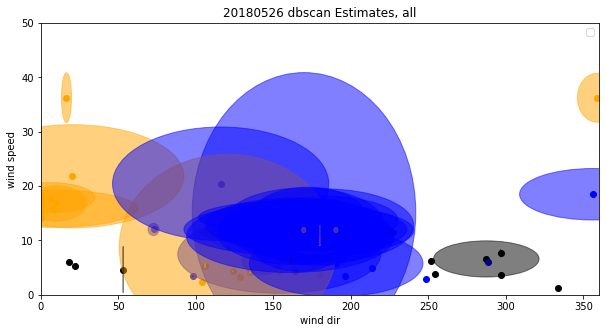

In [82]:
date_name = "20180526 dbscan"
er.plot_clstr_table(df_0526_dbs[df_0526_dbs["dir_std"] < 50 ], min_count=5, name=date_name).show

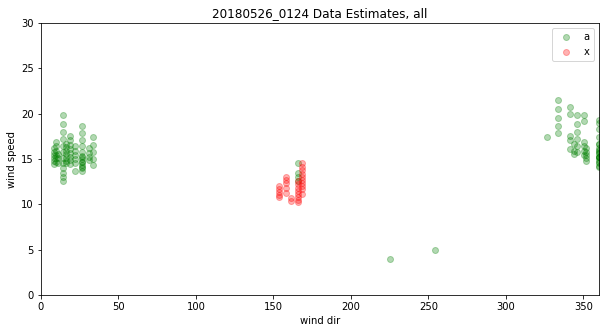

In [57]:
# pipeline iterating

peaks = []
p_class = []

plt.figure(figsize=(10,5))
plt.xlim([0, 360])
plt.ylim([0, 30])

#Cluster methods
# detect_cluster_meanshift
# detect_cluster_dbscan
# detect_cluster_affprop

for fts in fits_in:
    er_pipe = er.Estimate_simple(fts)
    asp, adir = er_pipe.run(clstr_method = er.detect_cluster_meanshift)
    xsp, xdir = er_pipe.run(clstr_method = er.detect_cluster_meanshift, xcor = True)
    plt.scatter(np.degrees(adir), asp, c="green",  alpha = .3, label="a")
    plt.scatter(np.degrees(xdir), xsp, c="red",  alpha = .3, label="x")
    asum = er_pipe.summary_cluster()
    xsum = er_pipe.summary_cluster(xcor = True)
    aclass, xclass = er_pipe.classify_peaks(asum, xsum)
    peaks.extend(asum)
    peaks.extend(xsum)
    p_class.extend(aclass)
    p_class.extend(xclass) 
                
plt.title('20180526_0124 Data Estimates, all')
plt.ylabel('wind speed')
plt.xlabel('wind dir')
plt.legend()

In [58]:
# creating a df
df = pd.DataFrame(peaks, columns =['dir', 'dir_std', 'spd', 'spd_std', 'count'], dtype = float) 
df['class'] = p_class 

df

,dir,dir_std,spd,spd_std,count,class
0,0.126512,0.288514,16.116931,1.705532,122.0,FL
1,2.896614,0.000000,13.403093,0.720014,4.0,GL
2,-1.849096,0.000000,4.975195,0.000000,1.0,FL
3,-2.356194,0.000000,3.984819,0.000000,1.0,FL
4,2.914554,0.042867,12.212054,1.193122,19.0,GL
5,2.733971,0.055089,11.450784,0.681973,11.0,GL


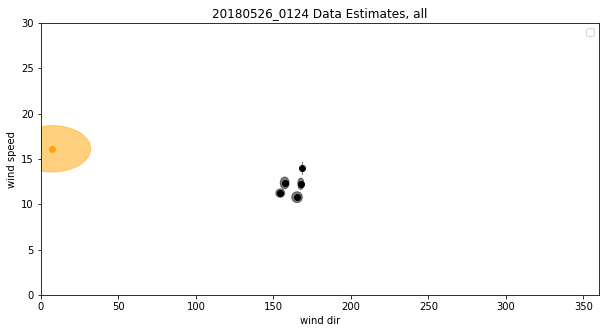

In [53]:
# Data Plot
plt.figure(figsize=(10,5))
plt.xlim([0, 360])
plt.ylim([0, 30])
ax = plt.gca()

for index, row in df.iterrows():
    clr  = det_color(row["class"])
    alph= 0.5
    plt.scatter(np.degrees(row['dir']), row['spd'], c=clr,  alpha = 1)
    spread = matplotlib.patches.Ellipse((np.degrees(row['dir']), row['spd']), 
                                        3*np.degrees(row['dir_std']), 3*row['spd_std'], 
                                        angle=0, color=clr, alpha=alph)
    ax.add_patch(spread)

plt.title('20180526_0124 Data Estimates, all')
plt.ylabel('wind speed')
plt.xlabel('wind dir')
plt.legend()

# 4. Estimator Testing: All Files

This goes through all files in the main CSV and finds / plots their estimates.

In [42]:
reload(er)

<module 'pipeline.code.Estimator_R' from '/home/emcewen/code_dev/pipeline/code/Estimator_R.py'>

In [44]:
# pulling in date
df_main = pd.read_csv("/home/emcewen/code_dev/csv/main.csv")
# filtering type of file
rslt_df = df_main[df_main['ttsub'] == True]
rslt_df = rslt_df.drop_duplicates(subset=['dataname'])
# pulling cov fits files
fits = rslt_df["outfits"]
#input fits
fits_main_in = fits.values

20180821_aocb0010o
20180821_aocb0102o
20180821_aocb0086o
20180821_aocb0135o
20180821_aocb0143o
20180821_aocb0062o
20180821_aocb0074o
20180821_aocb0054o
20180821_aocb0018o
20180821_aocb0000o
20180821_aocb0058o
20180821_aocb0030o
20180821_aocb0119o
20180821_aocb0070o
20180821_aocb0006o
20180821_aocb0078o
20180821_aocb0127o
20180821_aocb0098o
20180821_aocb0050o
20180821_aocb0046o
20180821_aocb0038o
20180821_aocb0022o
20180821_aocb0106o
20180821_aocb0002o
20180821_aocb0034o
20180821_aocb0014o
20180821_aocb0123o
20180821_aocb0066o
20180821_aocb0026o
20180821_aocb0090o
20180821_aocb0042o
20180821_aocb0082o
20180821_aocb0131o
20180821_aocb0139o
20180821_aocb0094o
20180822_aocb0078o
20180822_aocb0042o
20180822_aocb0046o
20180822_aocb0034o
20180822_aocb0005o
20180822_aocb0050o
20180822_aocb0054o
20180822_aocb0074o
20180822_aocb0018o
20180822_aocb0022o
20180822_aocb0066o
20180822_aocb0038o
20180822_aocb0058o
20180822_aocb0086o
20180822_aocb0070o
20180822_aocb0082o
20180822_aocb0030o
20180822_aoc

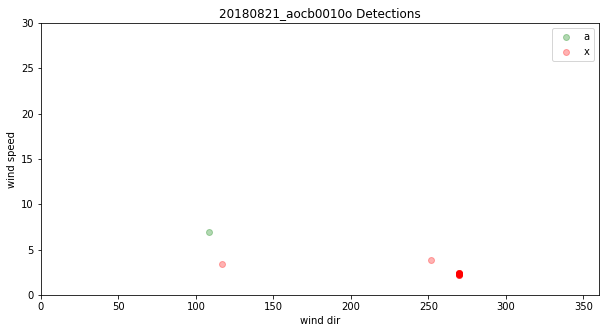

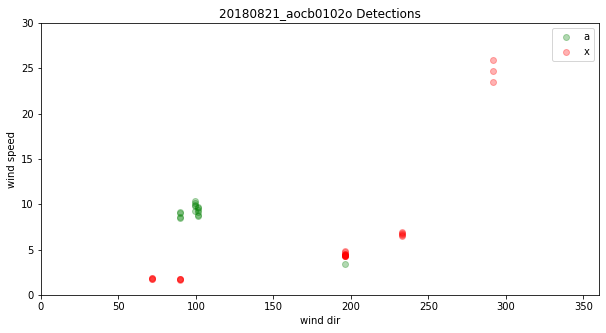

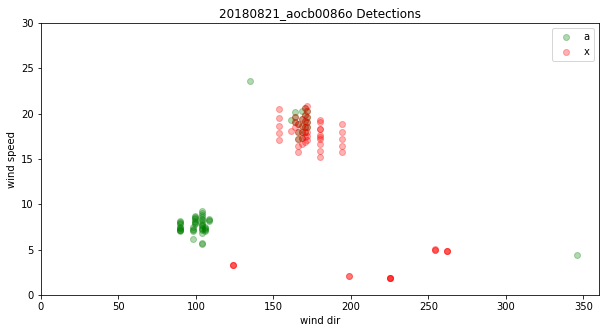

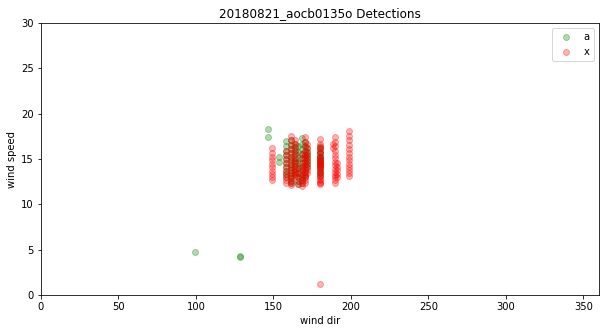

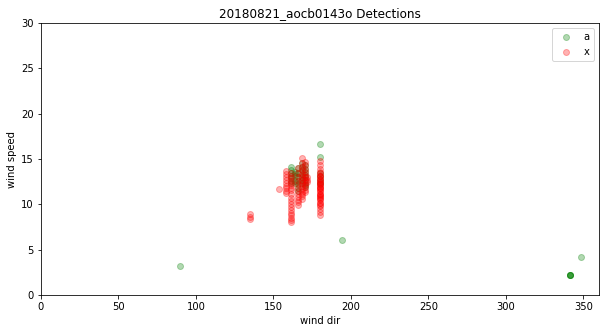

...

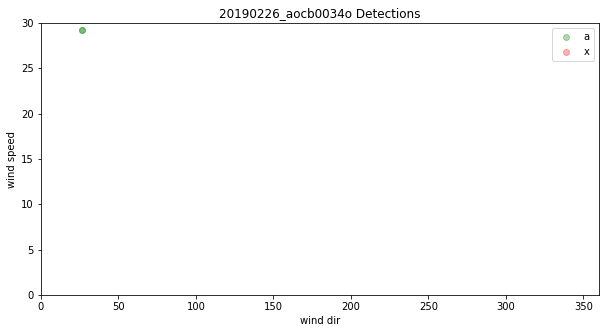

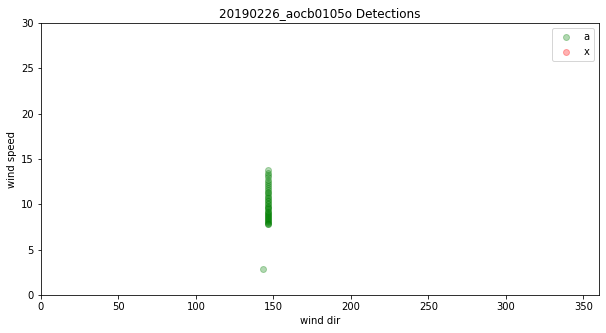

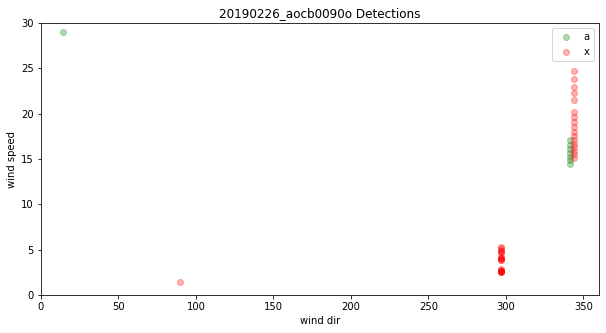

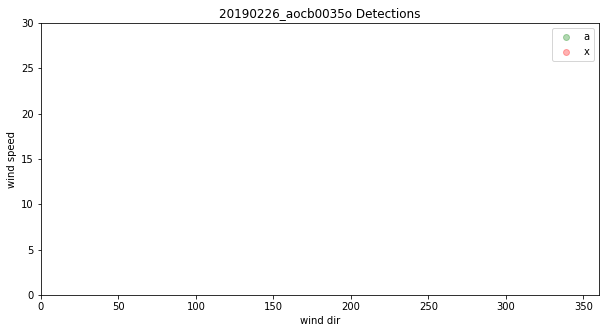

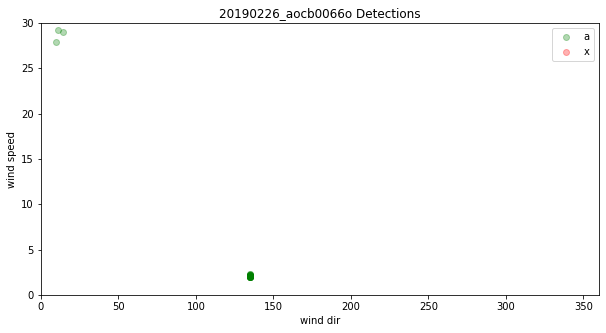

In [45]:
tic = time.perf_counter()
for i in fits_main_in:
    er.est_file(i, plot = True)
toc = time.perf_counter()
print(f"Estimates in {toc - tic:0.4f} seconds")

# Appendix: Old testing Code

In [93]:
# Change me
i = 6
## pulling data
outfits = f_dir + fits[i]
data = Correlator("", "", "", f_file=outfits)

In [94]:
# generating a processed corr cube
avg_awfs_x = xcor_map(data)
avg_awfs_a = acor_map(data)

# taking out the average pixel over time 
avg_awfs_sub_x = np.subtract(avg_awfs_x, np.average(avg_awfs_x, axis = 0))
avg_awfs_sub_a = np.subtract(avg_awfs_a, np.average(avg_awfs_a, axis = 0))


In [95]:
###########################
# PART 1 : determining detection levels
###########################

detect_lvl_x = detect_map(avg_awfs_sub_x)
detect_lvl_a = detect_map(avg_awfs_sub_a)

# checking detection levels
#t = 15
#detect_t = [ma.masked_where(detect_lvl[t] <= 4, detect_lvl[t]) for t in range(200)]

In [104]:
###########################
# Part 2 : Speed Map
###########################
detect_clp = 9
spds_x, dirs_x, xs_x, ys_x = speed_map(detect_lvl_x, detect_clp, 333)
spds_a, dirs_a, xs_a, ys_a = speed_map(detect_lvl_a, detect_clp, 333)

print(spds_a.shape)
print(spds_x.shape)

(100,)
(0,)


Text(0, 0.5, 'speed (m/s?)')

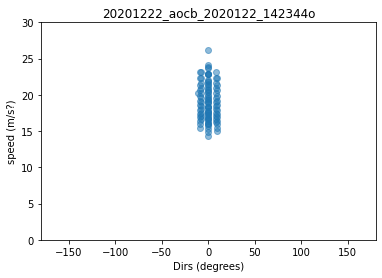

In [105]:
#checking speed outputs

plt.scatter(np.degrees(dirs_a), spds_a, alpha=0.5, c=t)
plt.scatter(np.degrees(dirs_x), spds_x, alpha=0.5, color="r")
plt.title(data.name)
plt.xlim([-180, 180])
plt.ylim([0, 30])
plt.xlabel('Dirs (degrees)')
plt.ylabel('speed (m/s?)')

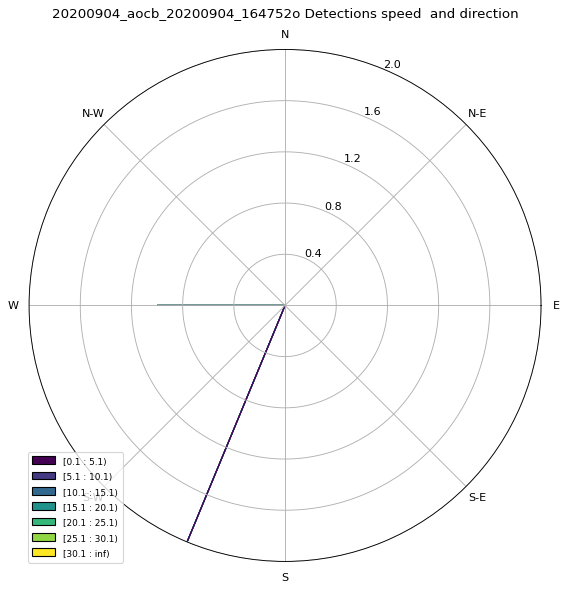

In [40]:
# Windplot for detections
from windrose import WindroseAxes

ax = WindroseAxes.from_ax()
ax.contourf((np.degrees(dirs) + 360)%360, spds, bins=np.arange(0.1, 35, 5), cmap=cm.viridis)
ax.set_legend()
ax.set_title(data.name + " Detections speed  and direction")
plt.show()

In [104]:
###########################
# Part 3 : Clustering?
###########################

============ Mean shift ==========
Dir:     0.0
  sdv:   0.19992082317120033
Spd:     19.60811950326069
  sdv:   3.200492785405047
Dir:     0.3217505543966422
  sdv:   0.23872724205530996
Spd:     14.500666296439086
  sdv:   0.5254619337062705
Dir:     -0.3217505543966422
  sdv:   0.24131064961599605
Spd:     14.479278836495968
  sdv:   0.5752943001564504


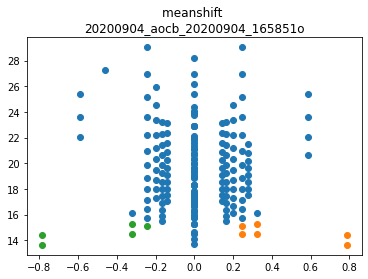

In [62]:
# mean shift clustering
detect_cluster_meanshift(data, spds, xs, ys)

============ DBSCAN ==========
Dir:     0.0
  sdv:   0.24188524634059017
Spd:     19.622213177926696
  sdv:   3.440597487048529
Dir:     0.0
  sdv:   0.0
Spd:     18.315
  sdv:   2.2469334198890887e-15
Dir:     0.0
  sdv:   0.0
Spd:     17.383928571428573
  sdv:   0.2789532575181112


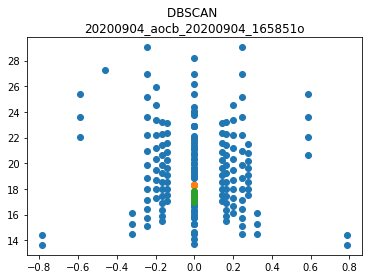

In [115]:
# dbscan clustering
detect_cluster_dbscan(data, spds, xs, ys)

============ Affinity Prop ==========
Dir:     -0.5880026035475675
  sdv:   0.0
Spd:     23.58416843218677
  sdv:   1.3836853632449826
Dir:     -0.24497866312686414
  sdv:   0.0940491217392983
Spd:     26.969528404709802
  sdv:   1.316785537744467
Dir:     0.5880026035475675
  sdv:   0.0
Spd:     23.58416843218677
  sdv:   1.3836853632449826
Dir:     0.0
  sdv:   0.11548404929534697
Spd:     26.951675967060783
  sdv:   1.1986637834914136
Dir:     -0.7853981633974483
  sdv:   0.0
Spd:     14.010948707747659
  sdv:   0.3786742893985844
Dir:     0.7853981633974483
  sdv:   0.0
Spd:     14.010948707747659
  sdv:   0.3786742893985844
Dir:     0.15352286600939538
  sdv:   0.15421451816690976
Spd:     21.17868051651114
  sdv:   0.4251399419267529
Dir:     0.19739555984988075
  sdv:   0.053644345370125746
Spd:     19.615166340593692
  sdv:   0.4765591123539844
Dir:     0.1812721186322538
  sdv:   0.05039455243745582
Spd:     17.96400590396314
  sdv:   0.5550562192796088
Dir:     -0.14189705460

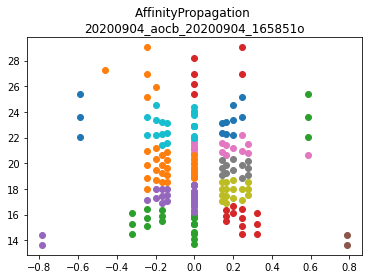

In [116]:
# affinity propagation clustering
detect_cluster_affprop(data, spds, xs, ys)

## Comparing Values, Checking answers

In [16]:
# Pulling Mark's Process
### radest_process/covmap.20200904_164752o.acov.fits
### radest_process/covmap.20200904_164752o.xcov.fits

xcov_file = "/home/emcewen/radest_process/covmap.20200904_164752o.xcov.fits"
xcov_mark = fits.open(xcov_file)[0].data

acov_file = "/home/emcewen/radest_process/covmap.20200904_164752o.acov.fits"
acov_mark = fits.open(acov_file)[0].data

meanmap_file = "/home/emcewen/radest_process/meanmap.20200904_164752o.acov.fits"
meanmap_mark = fits.open(meanmap_file)[0].data

stddev_file = "/home/emcewen/radest_process/stddevmap.20200904_164752o.acov.fits"
stddev_mark = fits.open(stddev_file)[0].data

# using other parts of mark's data using my code
#mark_lvl = np.divide(np.subtract(acov_mark, meanmap_mark), stddev_mark)

#importlib.reload(gc)
#gc.gif_1_mat_static(det_map_mark, 100, title="Detection xCov map MARK, " + data.name, out_file='detect_routine_'+'covmap.20200904_164752o.xcov'+'.gif', std_val=5)

In [97]:
# display matrix
"""
plt.matshow(means[28]-meanmap_mark[28])
plt.clim(4, 10)
plt.colorbar()
plt.show()
"""

# print matrix
np.ma.array([1,2,3], mask=[False, False, True]).mean()

print("a_wfs mean: ",np.average(avg_awfs_sub))
print("a_wfs mark: ",np.average(acov_mark))
print("a_wfs diff: ", np.average(avg_awfs_sub-acov_mark))
print(" ")
print("Means mean: ",np.average(means))
print("Means mark: ",np.average(meanmap_mark))
print("Means diff: ",np.average(means-meanmap_mark))
print(" ")
print("Sdev mean:  ", np.median(stdevs))
print("Sdev mark:  ", np.median(stddev_mark))
print("Sdev diff:  ", np.median(stdevs-stddev_mark))


a_wfs mean:  1.2274439188780062e-20
a_wfs mark:  1.3179579e-12
a_wfs diff:  -6.850150255239277e-13
 
Means mean:  -2.719175185681748e-05
Means mark:  -8.610494e-05
Means diff:  5.891318264383696e-05
 
Sdev mean:   0.0
Sdev mark:   0.0
Sdev diff:   -0.0002283571971882207


/home/emcewen/.local/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in less_equal
  


In [21]:
# Pulling Mark's detection Map for this matrix
### detection maps in ehu:/data/imaka/sim/20200904/ana/detmapXXX.fits

fits_file = "/data/imaka/sim/20200904/ana/detmap.20200904_164752o.acov.fits"

hdulist = fits.open(fits_file)
hdr = hdulist[0].header

det_map_mark = hdulist[0].data

#importlib.reload(gc)
#gc.gif_1_mat_static(det_map_mark, 100, title="Detection Level Matrix MARK, " + data.name, out_file='detect_lvl_sim_MARK'+'.gif', std_val=5)

In [11]:
# plotting average corr
importlib.reload(gc)


gc.gif_1_mat_static(avg_wfs-det_map_mark, 50, title="Simulation corr matrix DIFF, length 50, " + data.name, out_file='avg_corr_sim50t_'+ data.name+'.gif')

NameError: name 'det_map_mark' is not defined

In [22]:
# looking at just detections

detect_t = [ma.masked_where(det_map_mark[t] <= 4, det_map_mark[t]) for t in range(200)]
#gc.gif_1_mat_static(detect_t, 100, title="Detection Level CLip Matrix MARK, " + data.name, out_file='detect_lvl_clip_sim_MARK'+'.gif', std_val=5)

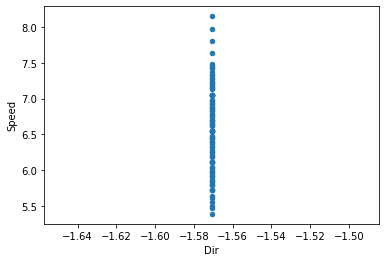

In [55]:
# Looking at Mark's clustered values

#
name1 = "/home/emcewen/data/radial_datapoints/radialvelocityapproachonsimulateddata20200904cl/20200904_aocb_20200904_163647o_tmax200_stt.fits.cluster.txt"
name2 = "/home/emcewen/data/radial_datapoints/radialvelocityapproachonsimulateddata20200904cl/20200904_aocb_20200904_164752o_tmax200_stt.fits.cluster.txt"
name3 = "/home/emcewen/data/radial_datapoints/radialvelocityapproachonsimulateddata20200904cl/20200904_aocb_20200904_165851o_tmax200_stt.fits.cluster.txt"

# Pulling in Mark's datapoints

df = pd.read_table(name2, delim_whitespace=True, names=('Speed', 'Dir', 'x', 'y'))


# Should be well clustered 
df.plot.scatter('Dir', 'Speed')

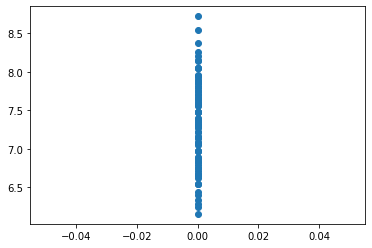

In [45]:
plt.scatter(dirs,spds)

## Looking at circular code

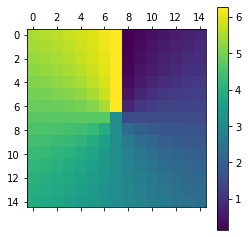

In [88]:
def dir_c(x,y,c):
    ang = np.arctan2(c-y, x-c)
    return ang + np.pi 
theta = np.array([[(dir_c(x,y, 7)) for y in range(15)] for x in range(15)])
plt.matshow(theta)
plt.colorbar()

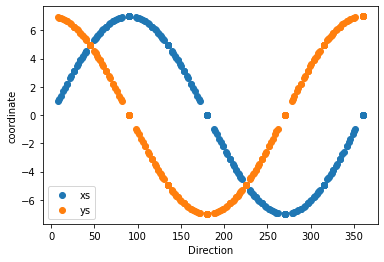

In [97]:
reload(er)
sx = [[er.proj_x(t, 7) for t in r] for r in theta]
sy = [[er.proj_y(t, 7) for t in r] for r in theta]
plt.scatter(np.degrees(theta), sx, label="xs")
plt.scatter(np.degrees(theta), sy, label="ys")
plt.xlabel("Direction")
plt.ylabel("coordinate")
plt.legend()